In [1]:
import os
import matplotlib.pyplot as plt
import pandas as pd
from PIL import Image, ImageOps
from tqdm import tqdm
import numpy as np
import torch
import math
import faiss
import random
from kmeans_pytorch import kmeans
from transformers import BlipProcessor, BlipForConditionalGeneration
from langchain.chat_models import ChatOllama
from langchain.schema import HumanMessage, SystemMessage
import re
import ast
import shutil
from transformers import CLIPProcessor, CLIPModel
from sklearn.decomposition import PCA
import plotly.express as px
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output, no_update
import networkx as nx

In [2]:
# Disable warnings
import warnings
warnings.filterwarnings('ignore')

# Load the Images from the Folder (single or multiple)


In [3]:
# Custom implementation of DeepImageSearch python package including:
# - Porting the training to work with GPU
# - Added shuffle parameter to the from_folder method in Load_Data class to shuffle the image paths before returning
# - Implemented image clustering using pytorch kmeans:
#   - cluster_images method, which clusters the indexed images into the specified number of clusters.
#   - get_clustered_images method, which returns the image paths in a specified cluster.
#   - plot_cluster_images method, which plots the images in a specified cluster.
#   - save_clustered_images method, which saves the images in each cluster to a folder with the cluster number.
# - Implemented image captioning using Hugging Face's Blip model:
#   - caption_images method, which captions the images from the specified paths and adds the captions to the dataframes.
# - Implemented image similarity search using Hugging Face's CLIP model:
#   - get_similar_images_to_text method, which returns the most similar images to a given text query according to the indexed image features. 
# Implemented universal plotting method:
#   - plot_images method, which plots the images with their captions (if provided).

# Define constants
DATASET_DIR = '../datasets/combined/images'
METADATA_DIR = 'clip_metadata'
IMAGE_DATA_FEATURES_FILE = 'image_data_features.pkl'
IMAGE_FEATURES_VECTORS_FILE = 'image_features_vectors.idx'
IMAGE_EXTENSIONS = ('.png', '.jpg', '.jpeg', '.gif', '.bmp')
MODEL_NAME_DEFAULT = 'openai/clip-vit-base-patch32'
CAPTION_MODEL_NAME_DEFAULT = 'Salesforce/blip-image-captioning-large'


def image_data_with_features_pkl(model_name):
    image_data_with_features_pkl = os.path.join(
        f'{METADATA_DIR}/', f'{model_name}/', IMAGE_DATA_FEATURES_FILE)
    return image_data_with_features_pkl


def image_features_vectors_idx(model_name):
    image_features_vectors_idx = os.path.join(
        f'{METADATA_DIR}/', f'{model_name}/', IMAGE_FEATURES_VECTORS_FILE)
    return image_features_vectors_idx


class Load_Data:
    """A class for loading data from single/multiple folders or a CSV file"""

    def __init__(self):
        """
        Initializes an instance of LoadData class
        """
        pass

    def from_folder(self, folder_list: list, shuffle=False):
        """
        Adds images from the specified folders to the image_list.

        Parameters:
        -----------
        folder_list : list
            A list of paths to the folders containing images to be added to the image_list.
        shuffle : bool, optional
            If True, shuffles the image paths before returning. Default is False.
        """
        self.folder_list = folder_list
        image_path = []
        for folder in self.folder_list:
            for root, dirs, files in os.walk(folder):
                for file in files:
                    if file.lower().endswith(IMAGE_EXTENSIONS):
                        image_path.append(os.path.join(root, file))
        if shuffle:
            random.shuffle(image_path)
        return image_path

    def from_csv(self, csv_file_path: str, images_column_name: str):
        """
        Adds images from the specified column of a CSV file to the image_list.

        Parameters:
        -----------
        csv_file_path : str
            The path to the CSV file.
        images_column_name : str
            The name of the column containing the paths to the images to be added to the image_list.
        """
        self.csv_file_path = csv_file_path
        self.images_column_name = images_column_name
        return pd.read_csv(self.csv_file_path)[self.images_column_name].to_list()


class Search_Setup:
    """ A class for setting up and running image similarity search."""

    def __init__(self, image_list: list, model_name=MODEL_NAME_DEFAULT, image_count: int = None, caption_model_name=CAPTION_MODEL_NAME_DEFAULT):
        """
        Parameters:
        -----------
        image_list : list
        A list of images to be indexed and searched.
        model_name : str, optional (default=MODEL_NAME_DEFAULT)
        The name of the pre-trained model to use for feature extraction.
        image_count : int, optional (default=None)
        The number of images to be indexed and searched. If None, all images in the image_list will be used.
        """
        self.device = torch.device(
            'cuda' if torch.cuda.is_available() else 'cpu')
        self.model_name = model_name
        self.image_data = pd.DataFrame()
        if image_count == None:
            self.image_list = image_list
        else:
            self.image_list = image_list[:image_count]

        if f'{METADATA_DIR}/{self.model_name}' not in os.listdir():
            try:
                os.makedirs(f'{METADATA_DIR}/{self.model_name}')
            except Exception as e:
                # Handle the exception
                print(
                    f'\033[91m An error occurred while creating the directory: {METADATA_DIR}/{self.model_name}')
                print(f'\033[91m  Error Details: {e}')
        # Load the pre-trained model and processor
        print("\033[91m Please Wait Model Is Loading or Downloading From Server!")
        self.processor = CLIPProcessor.from_pretrained(self.model_name)
        self.model = CLIPModel.from_pretrained(self.model_name).to(self.device)
        print(f"\033[92m Model Loaded Successfully: {model_name}")
        self.caption_model_name = caption_model_name

    def _extract(self, img):
        # Resize and convert the image
        img = img.resize((224, 224))
        img = img.convert('RGB')

        # Preprocess the image
        inputs = self.processor(images=img, return_tensors="pt", padding=True)
        inputs = {k: v.to(self.device) for k, v in inputs.items()}

        # Extract features
        with torch.no_grad():
            feature = self.model.get_image_features(**inputs)
        feature = feature.data.cpu().numpy().flatten()
        return feature / np.linalg.norm(feature)

    def _get_feature(self, image_data: list):
        self.image_data = image_data
        features = []
        for img_path in tqdm(self.image_data):  # Iterate through images
            # Extract features from the image
            try:
                feature = self._extract(img=Image.open(img_path))
                features.append(feature)
            except:
                # If there is an error, append None to the feature list
                features.append(None)
                continue
        return features

    def _start_feature_extraction(self):
        image_data = pd.DataFrame()
        image_data['images_paths'] = self.image_list
        f_data = self._get_feature(self.image_list)
        image_data['features'] = f_data
        image_data = image_data.dropna().reset_index(drop=True)
        image_data.to_pickle(image_data_with_features_pkl(self.model_name))
        print(
            f"\033[94m Image Meta Information Saved: [{METADATA_DIR}/{self.model_name}/{IMAGE_DATA_FEATURES_FILE}]")
        return image_data

    def _start_indexing(self, image_data):
        self.image_data = image_data
        # Length of item vector that will be indexed
        d = len(image_data['features'][0])
        self.d = d
        index = faiss.IndexFlatL2(d)
        features_matrix = np.vstack(
            image_data['features'].values).astype(np.float32)
        index.add(features_matrix)  # Add the features matrix to the index
        faiss.write_index(index, image_features_vectors_idx(self.model_name))
        print("\033[94m Saved The Indexed File:" +
              f"[{METADATA_DIR}/{self.model_name}/{IMAGE_FEATURES_VECTORS_FILE}]")

    def run_index(self):
        """
        Indexes the images in the image_list and creates an index file for fast similarity search.
        """
        if len(os.listdir(f'{METADATA_DIR}/{self.model_name}')) == 0:
            data = self._start_feature_extraction()
            self._start_indexing(data)
        else:
            print(
                "\033[91m Metadata and Features are already present, Do you want Extract Again? Enter yes or no")
            flag = str(input())
            if flag.lower() == 'yes':
                data = self._start_feature_extraction()
                self._start_indexing(data)
            else:
                print("\033[93m Meta data already Present, Please Apply Search!")
                print(os.listdir(f'{METADATA_DIR}/{self.model_name}'))
        self.image_data = pd.read_pickle(
            image_data_with_features_pkl(self.model_name))
        self.f = len(self.image_data['features'][0])

    def add_images_to_index(self, new_image_paths: list):
        """
        Adds new images to the existing index.

        Parameters:
        -----------
        new_image_paths : list
            A list of paths to the new images to be added to the index.
        """
        # Load existing metadata and index
        self.image_data = pd.read_pickle(
            image_data_with_features_pkl(self.model_name))
        index = faiss.read_index(image_features_vectors_idx(self.model_name))

        for new_image_path in tqdm(new_image_paths):
            # Extract features from the new image
            try:
                img = Image.open(new_image_path)
                feature = self._extract(img)
            except Exception as e:
                print(
                    f"\033[91m Error extracting features from the new image: {e}")
                continue

            # Add the new image to the metadata
            new_metadata = pd.DataFrame(
                {"images_paths": [new_image_path], "features": [feature]})
            # self.image_data = self.image_data.append(new_metadata, ignore_index=True)
            self.image_data = pd.concat(
                [self.image_data, new_metadata], axis=0, ignore_index=True)

            # Add the new image to the index
            index.add(np.array([feature], dtype=np.float32))

        # Save the updated metadata and index
        self.image_data.to_pickle(
            image_data_with_features_pkl(self.model_name))
        faiss.write_index(index, image_features_vectors_idx(self.model_name))

        print(
            f"\033[92m New images added to the index: {len(new_image_paths)}")

    def _search_by_vector(self, v, n: int):
        self.v = v
        self.n = n
        index = faiss.read_index(image_features_vectors_idx(self.model_name))
        D, I = index.search(np.array([self.v], dtype=np.float32), self.n)
        return dict(zip(I[0], self.image_data.iloc[I[0]]['images_paths'].to_list()))

    def _get_query_vector(self, image_path: str):
        self.image_path = image_path
        img = Image.open(self.image_path)
        query_vector = self._extract(img)
        return query_vector

    def plot_similar_images(self, image_path: str, number_of_images: int = 6):
        """
        Plots a given image and its most similar images according to the indexed image features.

        Parameters:
        -----------
        image_path : str
            The path to the query image to be plotted.
        number_of_images : int, optional (default=6)
            The number of most similar images to the query image to be plotted.
        """
        input_img = Image.open(image_path)
        input_img_resized = ImageOps.fit(input_img, (224, 224), Image.LANCZOS)
        plt.figure(figsize=(5, 5))
        plt.axis('off')
        plt.title('Input Image', fontsize=18)
        plt.imshow(input_img_resized)
        plt.show()

        query_vector = self._get_query_vector(image_path)
        img_list = list(self._search_by_vector(
            query_vector, number_of_images).values())

        grid_size = math.ceil(math.sqrt(number_of_images))
        axes = []
        fig = plt.figure(figsize=(20, 15))
        for a in range(number_of_images):
            axes.append(fig.add_subplot(grid_size, grid_size, a + 1))
            plt.axis('off')
            img = Image.open(img_list[a])
            img_resized = ImageOps.fit(img, (224, 224), Image.LANCZOS)
            plt.imshow(img_resized)
        fig.tight_layout()
        fig.subplots_adjust(top=0.93)
        fig.suptitle('Similar Result Found', fontsize=22)
        plt.show(fig)

    def get_similar_images(self, image_path: str, number_of_images: int = 10):
        """
        Returns the most similar images to a given query image according to the indexed image features.

        Parameters:
        -----------
        image_path : str
            The path to the query image.
        number_of_images : int, optional (default=10)
            The number of most similar images to the query image to be returned.
        """
        self.image_path = image_path
        self.number_of_images = number_of_images
        query_vector = self._get_query_vector(self.image_path)
        img_dict = self._search_by_vector(query_vector, self.number_of_images)
        return img_dict

    def get_similar_images_to_text(self, text: str, number_of_images: int = 10):
        """
        Returns the most similar images to a given text query according to the indexed image features.

        Parameters:
        -----------
        text : str
            The text query.
        number_of_images : int, optional (default=10)
            The number of most similar images to the text query to be returned.
        """

        # Function to get embeddings from the text
        def get_text_embeddings(text):
            inputs = self.processor(text=text, return_tensors="pt")
            inputs = {name: tensor.to(self.device)
                      for name, tensor in inputs.items()}
            outputs = self.model.get_text_features(**inputs)
            return outputs.detach().cpu().numpy()

        # Function to get the similarity score between the image and the text
        def get_similarity_score(image_embeddings, text_embeddings):
            return np.inner(image_embeddings, text_embeddings).flatten()

        self.text = text
        self.number_of_images = number_of_images
        text_embeddings = get_text_embeddings(self.text)
        image_data = pd.read_pickle(
            image_data_with_features_pkl(self.model_name))
        image_embeddings = np.vstack(image_data['features'].values)
        similarity_scores = get_similarity_score(
            image_embeddings, text_embeddings)
        sorted_indices = np.argsort(similarity_scores)[::-1]
        similar_images = image_data.iloc[sorted_indices[:self.number_of_images]]
        img_dict = dict(
            zip(similar_images['images_paths'], similarity_scores[sorted_indices]))
        return img_dict

    def get_image_metadata_file(self):
        """
        Returns the metadata file containing information about the indexed images.

        Returns:
        --------
        DataFrame
            The Panda DataFrame of the metadata file.
        """
        self.image_data = pd.read_pickle(
            image_data_with_features_pkl(self.model_name))
        return self.image_data

    def cluster_images(self, n_clusters: int):
        """
        Clusters the indexed images into the specified number of clusters.

        Parameters:
        -----------
        n_clusters : int
            The number of clusters to create.
        """
        self.n_clusters = n_clusters
        self.image_data = pd.read_pickle(
            image_data_with_features_pkl(self.model_name))
        features = np.vstack(self.image_data['features'].values)

        # Convert features to PyTorch tensor and move to GPU
        data = torch.from_numpy(features).float().cuda()

        # Perform kmeans clustering
        cluster_ids_x, cluster_centers = kmeans(
            X=data, num_clusters=self.n_clusters, distance='euclidean', device=torch.device('cuda:0')
        )

        self.image_data['cluster'] = cluster_ids_x.cpu().numpy()
        return self.image_data

    def get_clustered_images(self, cluster_id: int):
        """
        Returns the image paths in a specified cluster.

        Parameters:
        -----------
        cluster_id : int
            The cluster ID of the images to be returned.
        """
        self.cluster_id = cluster_id
        cluster_images = self.image_data[self.image_data['cluster']
                                         == self.cluster_id]
        img_list = cluster_images['images_paths'].to_list()
        return img_list

    def plot_cluster_images(self, cluster_id: int, number_of_images=None):
        """
        Plots the images in a specified cluster.

        Parameters:
        -----------
        cluster_id : int
            The cluster ID of the images to be plotted.
        number_of_images : int, optional (default=None)
            The number of images to be plotted. If None, all images in the cluster will be plotted.
        """
        img_list = self.get_clustered_images(cluster_id)
        self.number_of_images = number_of_images or len(img_list)

        grid_size = math.ceil(math.sqrt(self.number_of_images))
        axes = []
        fig = plt.figure(figsize=(20, 15))
        for a in range(self.number_of_images):
            axes.append(fig.add_subplot(grid_size, grid_size, a + 1))
            plt.axis('off')
            img = Image.open(img_list[a])
            img_resized = ImageOps.fit(img, (224, 224), Image.LANCZOS)
            plt.imshow(img_resized)
        fig.tight_layout()
        fig.subplots_adjust(top=0.93)
        fig.suptitle(f'Cluster {self.cluster_id}', fontsize=22)
        plt.show(fig)

    def save_clustered_images(self, save_dir: str):
        """
        Saves the images in each cluster to a folder with the cluster number.

        Parameters:
        -----------
        save_dir : str
            The path to the directory where the images in each cluster will be saved.
        """
        self.save_dir = save_dir
        os.makedirs(self.save_dir, exist_ok=True)
        for i in range(self.n_clusters):
            os.makedirs(f'{self.save_dir}/{i}', exist_ok=True)
            cl = self.image_data[self.image_data['cluster'] == i]
            for j in cl['images_paths']:
                shutil.copy(j, f"{self.save_dir}/{i}")

    def caption_images(self, images_paths: list, starting_text: str = 'This is a'):
        """
        Captions the images from the specified paths and adds the captions to the dataframes.

        Parameters:
        -----------
        images_paths : list
            A list of paths to the images to be captioned.
        starting_text : str, optional
            The starting text for the captions. Default is 'This is a'.
        """

        processor = BlipProcessor.from_pretrained(self.caption_model_name)
        model = BlipForConditionalGeneration.from_pretrained(
            self.caption_model_name).to(self.device)

        images_paths_df = pd.DataFrame(images_paths, columns=['image_path'])
        captions = []
        for img_path in tqdm(images_paths):
            raw_image = Image.open(img_path)
            inputs = processor(raw_image, text=starting_text,
                               return_tensors="pt").to(self.device)
            out = model.generate(**inputs)
            caption = processor.decode(out[0], skip_special_tokens=True)
            captions.append(caption)

        images_paths_df['caption'] = captions

        return images_paths_df

    def plot_images(self, images_df: pd.DataFrame, caption_col: str = None):
        """
        Plots the images with their captions (if provided).

        Parameters:
        -----------
        images_df : pd.DataFrame
            A DataFrame containing the image paths and optionally their captions.
        caption_col : str, optional
            The name of the column containing the captions. If None, no captions are used.
        """

        grid_size = math.ceil(math.sqrt(len(images_df)))
        axes = []
        fig = plt.figure(figsize=(20, 15))
        for i in range(len(images_df)):
            axes.append(fig.add_subplot(grid_size, grid_size, i + 1))
            plt.axis('off')
            img = Image.open(images_df['image_path'][i])
            img_resized = ImageOps.fit(img, (224, 224), Image.LANCZOS)
            plt.imshow(img_resized)
            if caption_col and caption_col in images_df.columns:
                plt.title(images_df[caption_col][i])
        fig.tight_layout()
        plt.show()

In [4]:
# Load images from a folder
image_list = Load_Data().from_folder([DATASET_DIR], shuffle=True)

# Indexing Data


In [5]:
# Set up the search engine, You can load 'vit_base_patch16_224_in21k', 'resnet50' etc more then 500+ models
st = Search_Setup(image_list=image_list, model_name=MODEL_NAME_DEFAULT)

 Please Wait Model Is Loading or Downloading From Server!


 Model Loaded Successfully: openai/clip-vit-base-patch32


In [6]:
# Index the images
st.run_index()

100%|██████████| 9145/9145 [01:38<00:00, 92.54it/s] 


 Image Meta Information Saved: [clip_metadata/openai/clip-vit-base-patch32/image_data_features.pkl]
 Saved The Indexed File:[clip_metadata/openai/clip-vit-base-patch32/image_features_vectors.idx]


In [7]:
# Load the metadata of the images
metadata = st.get_image_metadata_file()
metadata

,images_paths,features
0,../datasets/combined/images/BACKGROUND_Google/...,"[0.012461396, -0.00781414, -0.025251796, -0.02..."
1,../datasets/combined/images/airplanes/image_04...,"[-0.0034987386, -0.010604609, 0.013329749, 0.0..."
2,../datasets/combined/images/Faces_easy/image_0...,"[0.03149004, -0.002504653, -0.032794815, -0.00..."
3,../datasets/combined/images/gramophone/image_0...,"[-0.036750384, -0.019368265, -0.023203522, -0...."
4,../datasets/combined/images/saxophone/image_00...,"[0.03380368, 0.027417958, -0.034775786, -0.030..."
...,...,...
9140,../datasets/combined/images/ewer/image_0005.jpg,"[-0.024544835, 0.025817793, -0.015027134, 0.01..."
9141,../datasets/combined/images/minaret/image_0071...,"[0.0036859007, -0.018519659, 0.0067552426, -0...."
9142,../datasets/combined/images/menorah/image_0030...,"[0.004071906, 0.03459982, -0.034108937, -0.048..."
9143,../datasets/combined/images/rhino/image_0042.jpg,"[0.0055582025, -0.044128664, -0.001830475, -0...."


In [8]:
# Search for similar images to the first image in the list
img_path = image_list[0]
st.get_similar_images(image_path=img_path, number_of_images=5)

{0: '../datasets/combined/images/BACKGROUND_Google/image_0158.jpg',
 1473: '../datasets/combined/images/BACKGROUND_Google/image_0048.jpg',
 8628: '../datasets/combined/images/BACKGROUND_Google/image_0032.jpg',
 1619: '../datasets/combined/images/laptop/image_0005.jpg',
 5160: '../datasets/combined/images/camera/image_0035.jpg'}

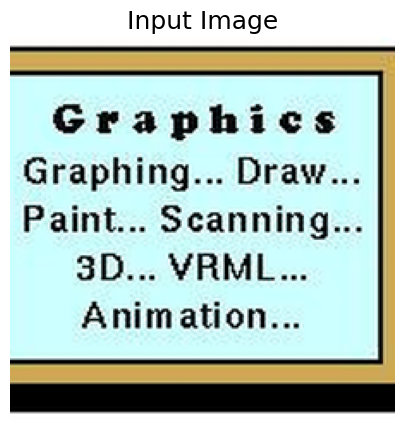

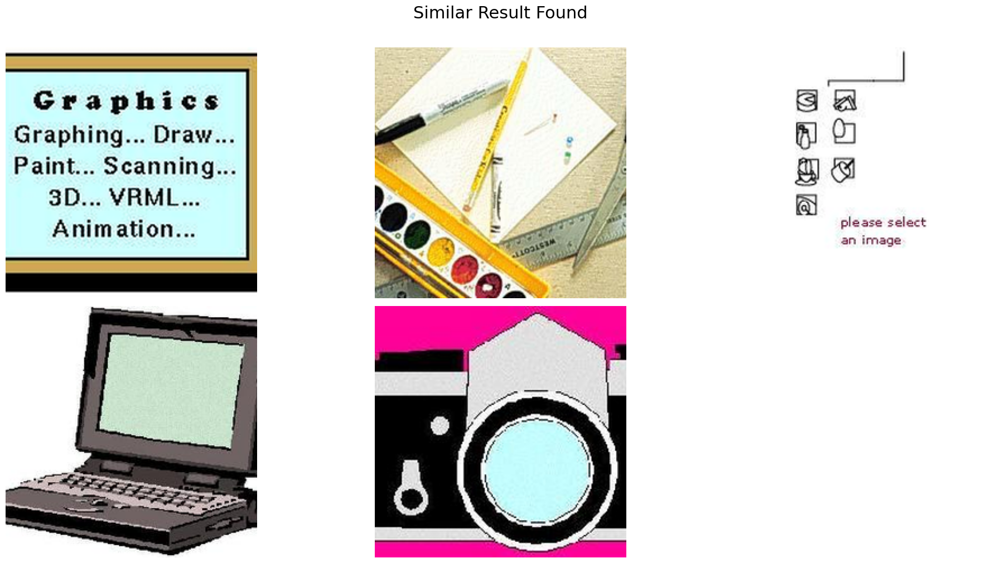

In [9]:
# Plot similar images to the first image in the list
img_path = image_list[0]
st.plot_similar_images(image_path=img_path, number_of_images=5)

In [10]:
# get similar images to a text query
text = "a cat"
st.get_similar_images_to_text(text=text, number_of_images=5)

{'../datasets/combined/images/wild_cat/image_0025.jpg': 3.1483939,
 '../datasets/combined/images/wild_cat/image_0029.jpg': 3.1322854,
 '../datasets/combined/images/brontosaurus/image_0034.jpg': 3.0367315,
 '../datasets/combined/images/cougar_body/image_0003.jpg': 2.995757,
 '../datasets/combined/images/wild_cat/image_0012.jpg': 2.9809647}

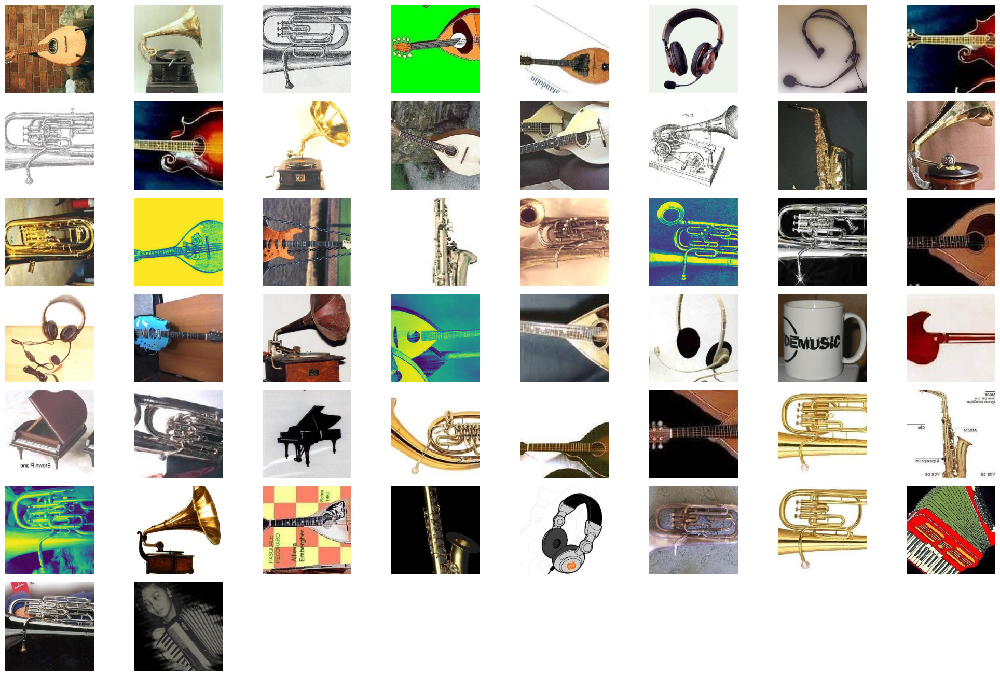

In [11]:
# plot the similar images to a text query
text = "music"
img_dict = st.get_similar_images_to_text(text=text, number_of_images=50)
img_paths = list(img_dict.keys())
st.plot_images(images_df=pd.DataFrame(img_paths, columns=['image_path']))

# Cluster the vector embeddings from metadata


In [12]:
NUMBER_OF_CLUSTERS = 10
clustered_images = st.cluster_images(n_clusters=NUMBER_OF_CLUSTERS)
clustered_images.head()

running k-means on cuda:0..


[running kmeans]: 0it [00:00, ?it/s]

[running kmeans]: 29it [00:01, 24.11it/s, center_shift=0.000095, iteration=29, tol=0.000100]


,images_paths,features,cluster
0,../datasets/combined/images/BACKGROUND_Google/...,"[0.012461396, -0.00781414, -0.025251796, -0.02...",3
1,../datasets/combined/images/airplanes/image_04...,"[-0.0034987386, -0.010604609, 0.013329749, 0.0...",1
2,../datasets/combined/images/Faces_easy/image_0...,"[0.03149004, -0.002504653, -0.032794815, -0.00...",2
3,../datasets/combined/images/gramophone/image_0...,"[-0.036750384, -0.019368265, -0.023203522, -0....",9
4,../datasets/combined/images/saxophone/image_00...,"[0.03380368, 0.027417958, -0.034775786, -0.030...",9


In [13]:
# Get the image paths of the first cluster
st.get_clustered_images(cluster_id=0)

['../datasets/combined/images/Motorbikes/image_0458.jpg',
 '../datasets/combined/images/Motorbikes/image_0579.jpg',
 '../datasets/combined/images/Motorbikes/image_0205.jpg',
 '../datasets/combined/images/Motorbikes/image_0211.jpg',
 '../datasets/combined/images/Motorbikes/image_0134.jpg',
 '../datasets/combined/images/Motorbikes/image_0388.jpg',
 '../datasets/combined/images/Motorbikes/image_0213.jpg',
 '../datasets/combined/images/Motorbikes/image_0117.jpg',
 '../datasets/combined/images/Motorbikes/image_0083.jpg',
 '../datasets/combined/images/Motorbikes/image_0173.jpg',
 '../datasets/combined/images/Motorbikes/image_0496.jpg',
 '../datasets/combined/images/Motorbikes/image_0191.jpg',
 '../datasets/combined/images/Motorbikes/image_0204.jpg',
 '../datasets/combined/images/Motorbikes/image_0566.jpg',
 '../datasets/combined/images/Motorbikes/image_0098.jpg',
 '../datasets/combined/images/Motorbikes/image_0531.jpg',
 '../datasets/combined/images/Motorbikes/image_0380.jpg',
 '../datasets/

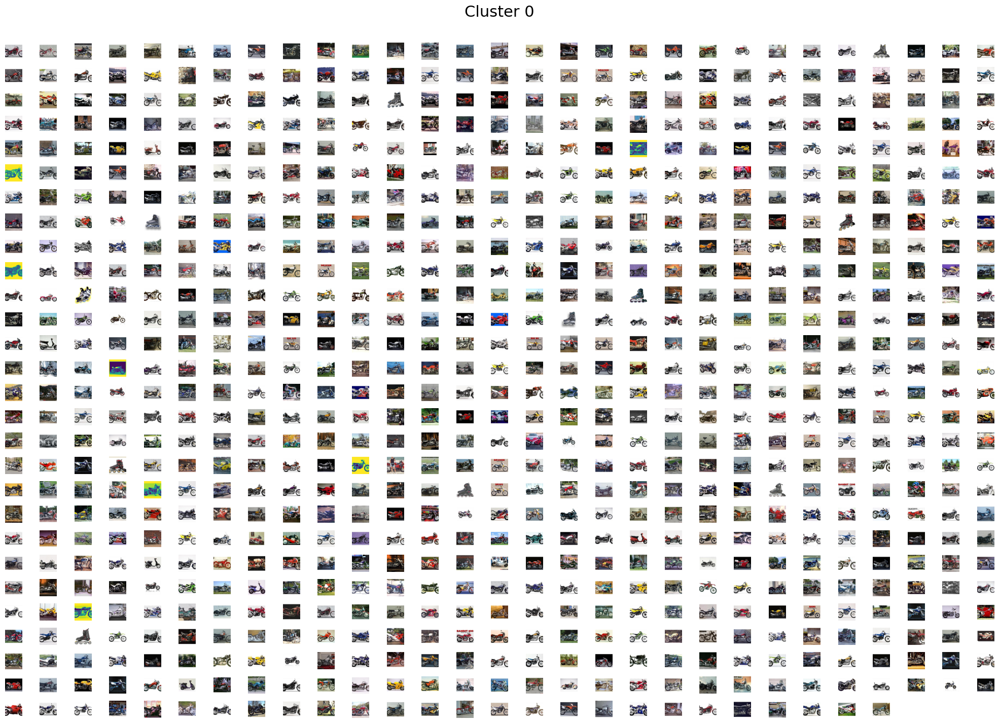

In [14]:
# Plot all images in the first cluster
st.plot_cluster_images(cluster_id=0)

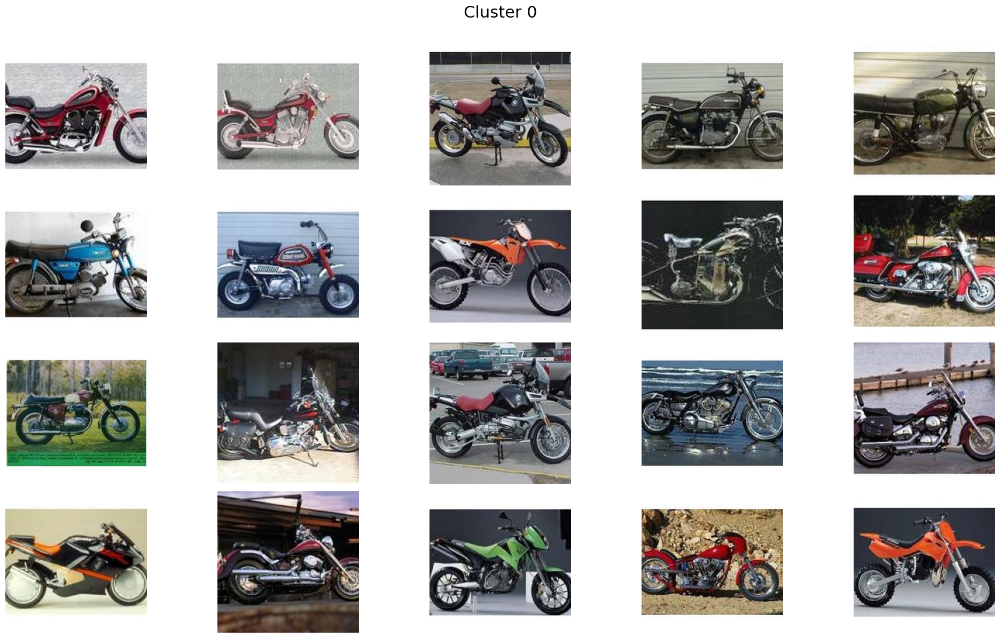

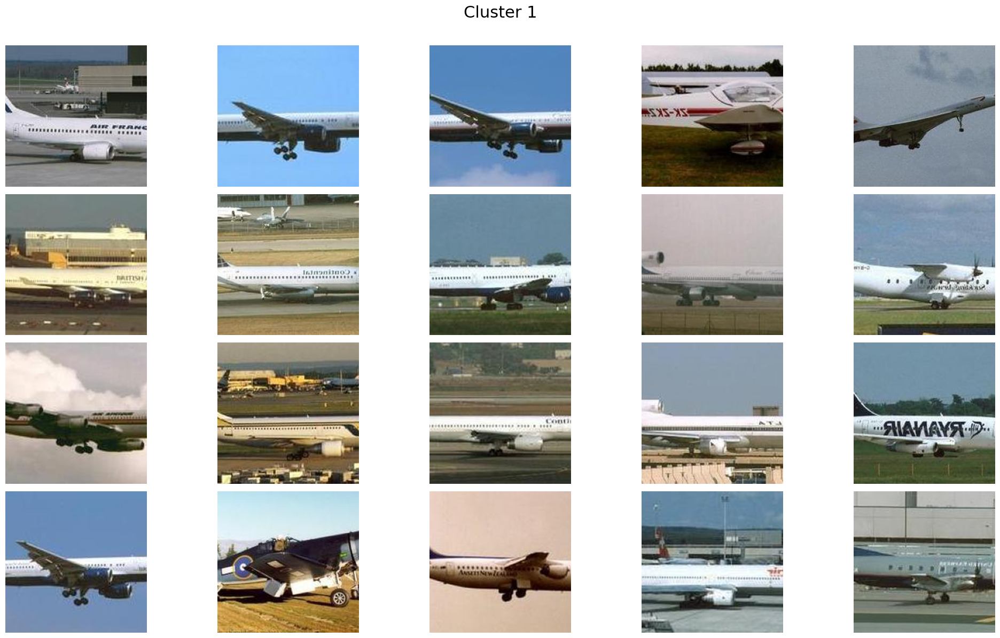

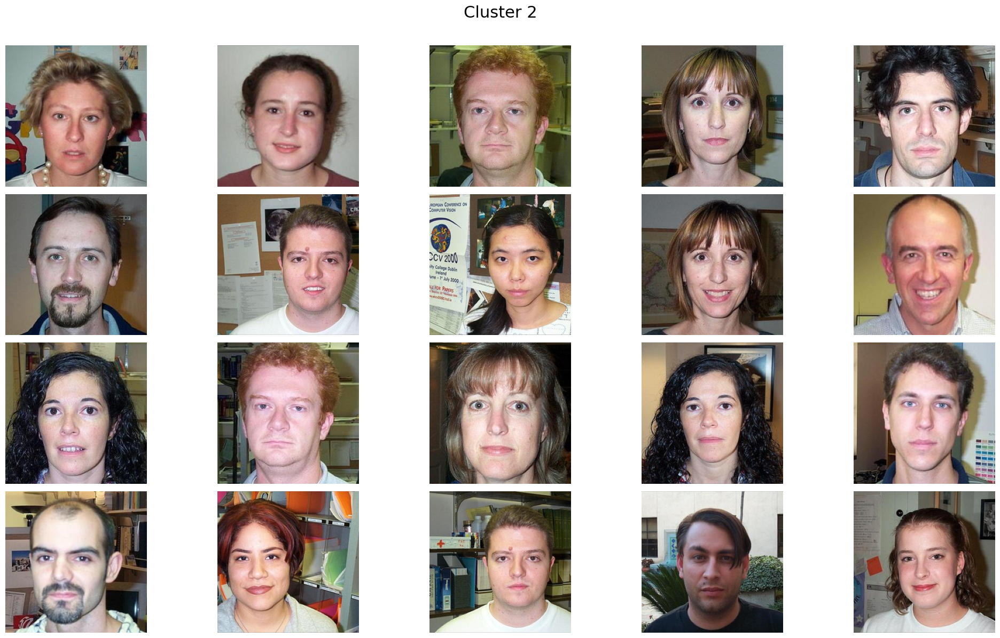

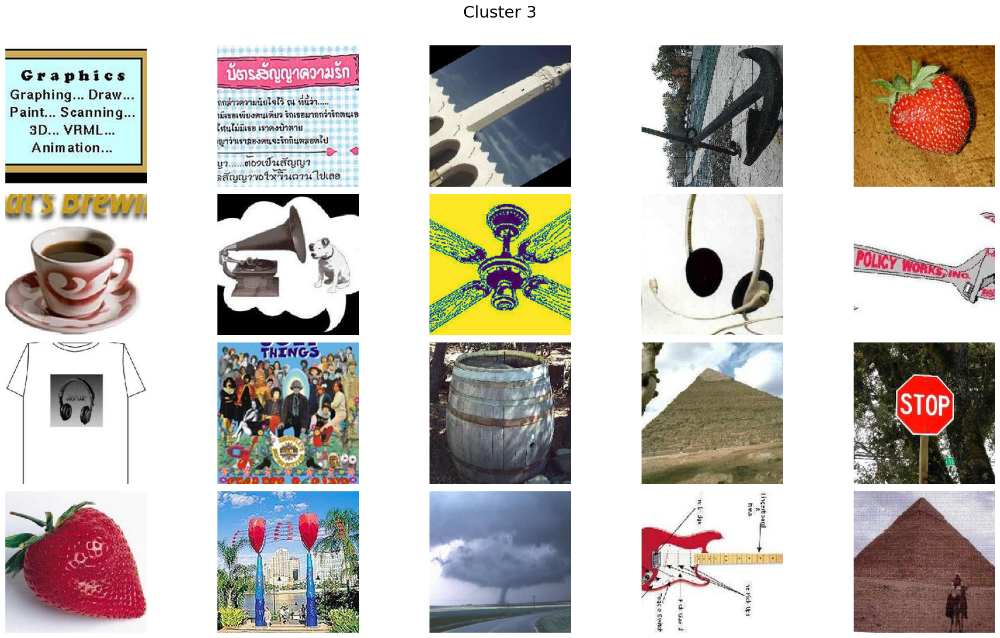

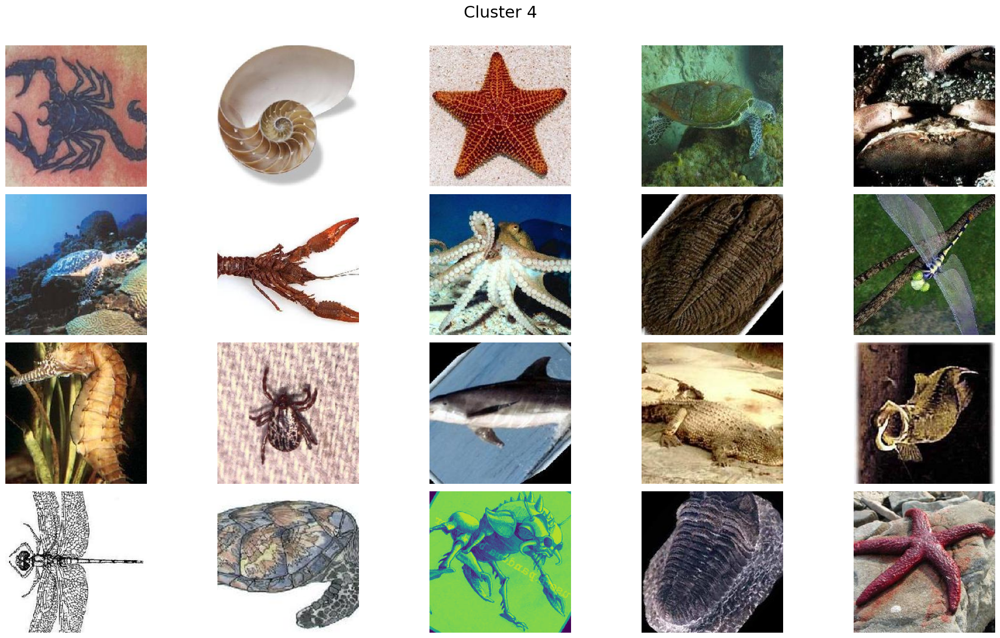

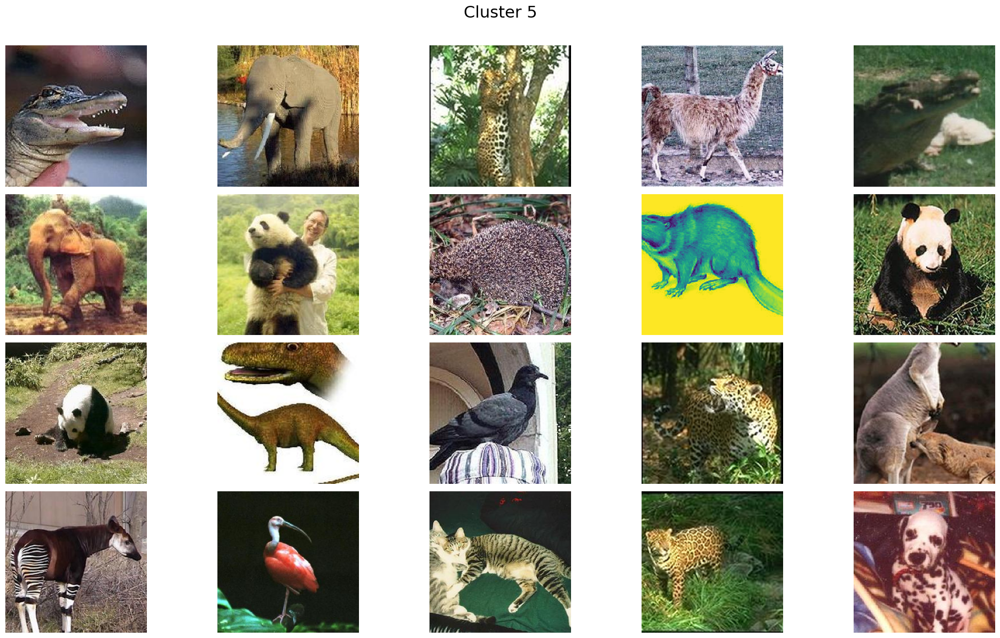

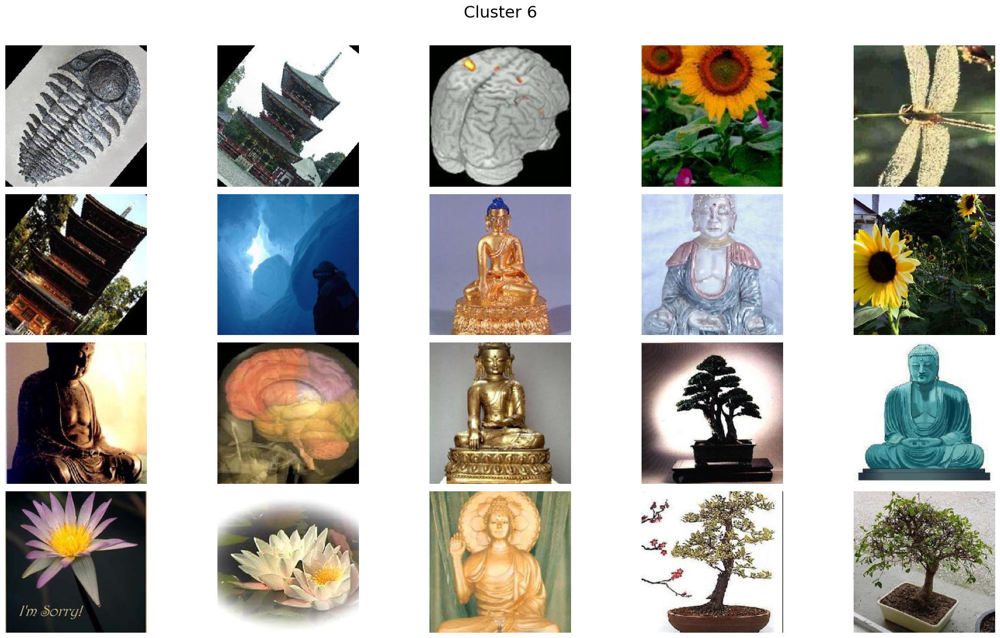

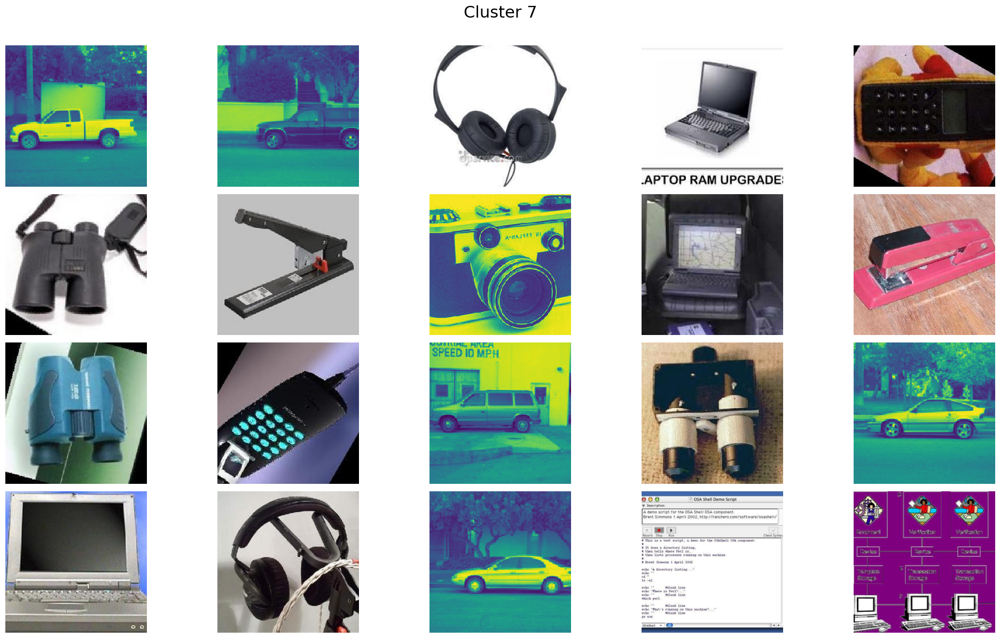

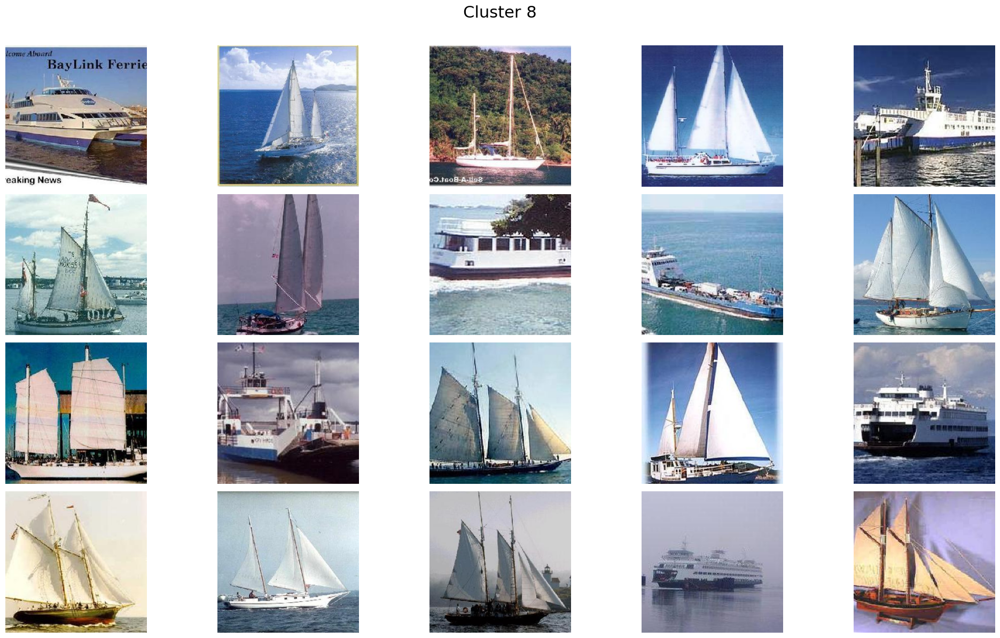

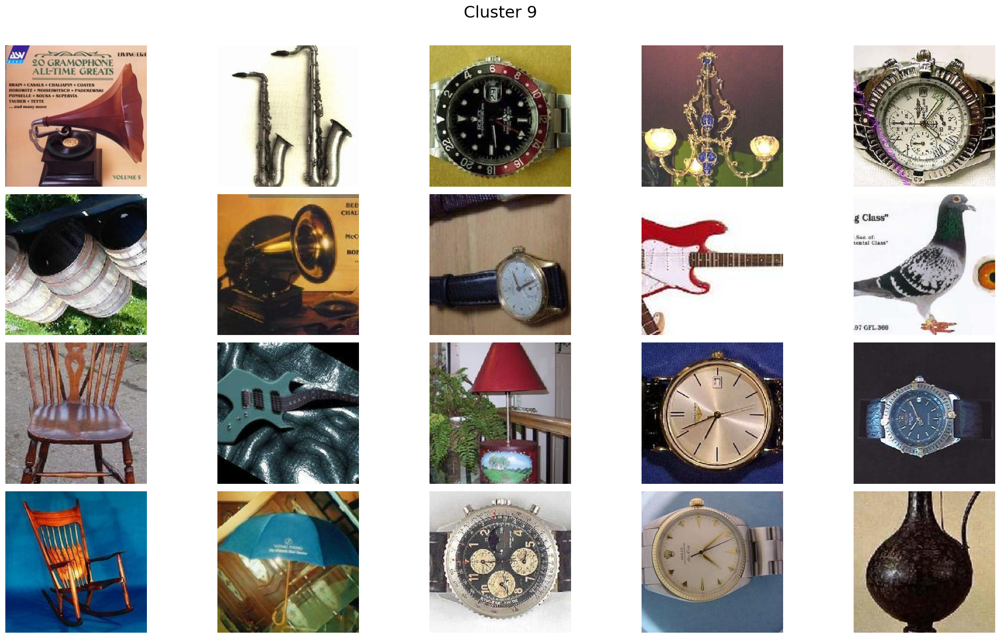

In [15]:
# Plot the first 20 images in each cluster
for i in range(NUMBER_OF_CLUSTERS):
    st.plot_cluster_images(cluster_id=i, number_of_images=20)

In [16]:
# Save each cluster to a folder with the cluster number
CLUSTERS_FOLDER_PATH = f'./clusters_{NUMBER_OF_CLUSTERS}'
st.save_clustered_images(save_dir=CLUSTERS_FOLDER_PATH)

100%|██████████| 15/15 [00:02<00:00,  5.72it/s]


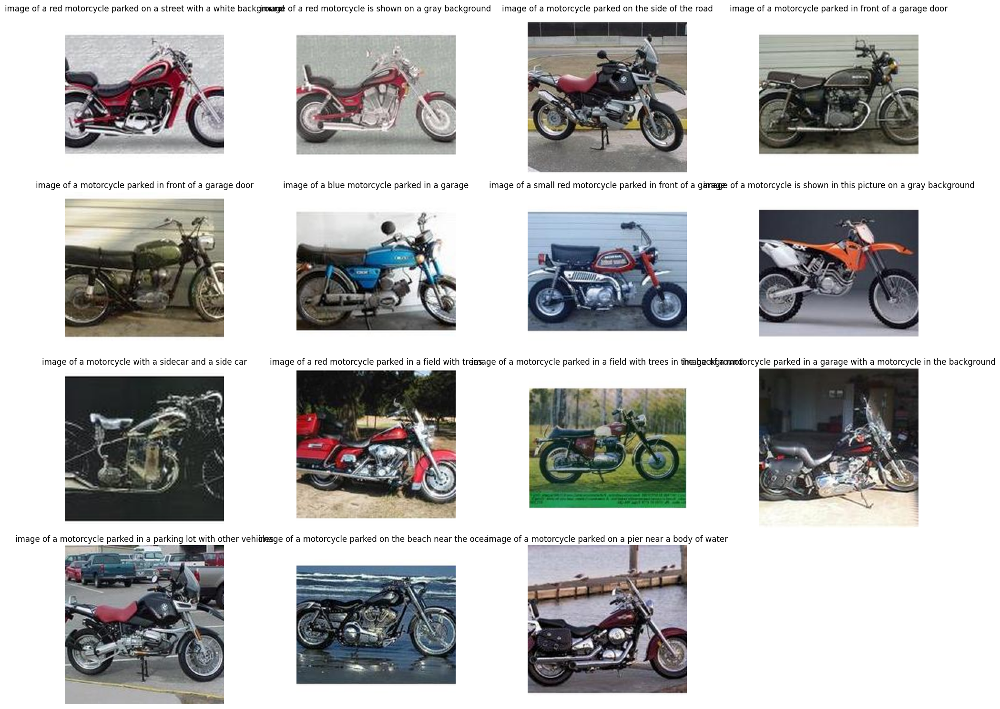

In [17]:
# Caption the first 15 images in the first cluster
cluster_0 = st.get_clustered_images(cluster_id=0)[:15]
captioned_images = st.caption_images(images_paths=cluster_0, starting_text='image of')
st.plot_images(images_df=captioned_images, caption_col='caption')

In [18]:
LLM_MODEL = "mistral:7b"

chat = ChatOllama(
    model=LLM_MODEL,
    temperature=0.8,
)

def get_best_topics(texts, tries=0):
    def prompt(texts):
        return f"""
    You have been provided with the following list of descriptions of images:
    descriptions: {texts}

    What is the best topic that describes these texts?
    If you think the texts are about multiple topics, write them in a python list like this:
    "Topic: ['landscapes', 'people', 'rocks']"
    Don't pick more than a 3 topics.
    
    Write the topic/topics in lowercase without any other special characters or spaces.
    Make sure to write the topic in the desired format.
    
    Answer in a python list format only.
    Topic: ['topic']

    Don't include any other information in your response. No clarifications or additional information.
    """

    answer = chat(
        [
            SystemMessage(content=prompt(texts)),
            HumanMessage(content="What is the best topic for these texts?"),
        ]
    ).content

    match = re.search(r'Topic: (\[.*\])', answer)
    if match:
        return ast.literal_eval(match.group(1))
    elif tries < 3:
        return get_best_topics(texts, tries + 1)
    else:
        return ["Other"]

# Get the best topic for the first 10 images in the first cluster
texts = captioned_images['caption'].to_list()
get_best_topics(texts)

# Get the best topic for the first 10 images in the first cluster
texts = captioned_images['caption'].to_list()
get_best_topics(texts)

['vehicles', 'scenes']

In [19]:
# Get the topics for all clusters
for i in range(NUMBER_OF_CLUSTERS):
    cluster_images = st.get_clustered_images(cluster_id=i)[:15]
    captioned_images = st.caption_images(images_paths=cluster_images)
    texts = captioned_images['caption'].to_list()
    topics = get_best_topics(texts)
    # TODO: Perform another clustering with topics length if it's more than 1
    clustered_images.loc[clustered_images['cluster'] == i, 'topic'] = topics[0] if len(
        topics) == 1 else '_'.join(topics)
    print(f"Cluster {i}: {topics}")

100%|██████████| 15/15 [00:02<00:00,  5.95it/s]


Cluster 0: ['vehicles', 'parking']


100%|██████████| 15/15 [00:02<00:00,  5.79it/s]


Cluster 1: ['airplanes', 'runways']


100%|██████████| 15/15 [00:03<00:00,  4.65it/s]


Cluster 2: ['people']


100%|██████████| 15/15 [00:02<00:00,  5.56it/s]


Cluster 3: ['pictures', 'objects']


100%|██████████| 15/15 [00:02<00:00,  5.80it/s]


Cluster 4: ['animals', 'nature']


100%|██████████| 15/15 [00:02<00:00,  5.80it/s]


Cluster 5: ['wildlife', 'animals']


100%|██████████| 15/15 [00:02<00:00,  5.69it/s]


Cluster 6: ['nature', 'buildings', 'statues']


100%|██████████| 15/15 [00:02<00:00,  5.70it/s]


Cluster 7: ['technology', 'photography']


100%|██████████| 15/15 [00:02<00:00,  5.69it/s]


Cluster 8: ['sailboats', 'water', 'ocean']


100%|██████████| 15/15 [00:02<00:00,  5.64it/s]


Cluster 9: ['objects', 'musical_instruments']


In [20]:
# copy CLUSTERS_FOLDER_PATH to CLUSTERS_FOLDER_PATH}_topics, renaming the folders inside to correspond topic
CLUSTERS_FOLDER_PATH_TOPICS = f'{CLUSTERS_FOLDER_PATH}_topics'
os.makedirs(CLUSTERS_FOLDER_PATH_TOPICS, exist_ok=True)
for i in range(NUMBER_OF_CLUSTERS):
    topics = clustered_images[clustered_images['cluster'] == i]['topic'].values[0]
    os.makedirs(f'{CLUSTERS_FOLDER_PATH_TOPICS}/{i}_{topics}', exist_ok=True)
    shutil.copytree(f'{CLUSTERS_FOLDER_PATH}/{i}', f'{CLUSTERS_FOLDER_PATH_TOPICS}/{i}_{topics}', dirs_exist_ok=True)

In [21]:
# Visualize the clustered CLIP embeddings in 2D with Principal Component Analysis
pca = PCA(n_components=2)
features = np.vstack(clustered_images['features'].values)

# Fit the PCA model and transform the features
pca_result = pca.fit_transform(features)

# Create a DataFrame with the PCA results
pca_df = pd.DataFrame(pca_result, columns=['PCA1', 'PCA2'])
pca_df['cluster'] = clustered_images['cluster']
pca_df['topic'] = clustered_images['topic']

# Plot the PCA results
fig = px.scatter(pca_df, x='PCA1', y='PCA2', color='topic', hover_data=['cluster'])
fig.show()

In [22]:
# Visualize the clustered CLIP embeddings in 3D with Principal Component Analysis
pca = PCA(n_components=3)
features = np.vstack(clustered_images['features'].values)

# Fit the PCA model and transform the features
pca_result = pca.fit_transform(features)

# Create a DataFrame with the PCA results
pca_df = pd.DataFrame(pca_result, columns=['PCA1', 'PCA2', 'PCA3'])
pca_df['cluster'] = clustered_images['cluster']
pca_df['topic'] = clustered_images['topic']
pca_df['images_paths'] = clustered_images['images_paths']

# Plot the PCA results
fig = px.scatter_3d(pca_df, x='PCA1', y='PCA2', z='PCA3', color='topic', hover_data=['cluster'])
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0), autosize=False, width=800, height=800)
fig.show()

In [23]:
# Interactive 3D scatter plot with Plotly and Dash
fig = go.Figure(data=[
    go.Scatter3d(
        x=pca_df["PCA1"],
        y=pca_df["PCA2"],
        z=pca_df["PCA3"],
        mode="markers",
        marker=dict(
            color=pca_df["cluster"],
            size=10,
            line={"color": "#444"},
            opacity=0.8,
        )
    )
])

fig.update_traces(hoverinfo="none", hovertemplate=None)

fig.update_layout(
    autosize=False, 
    width=800, 
    height=800,
    margin=dict(l=0, r=0, b=0, t=0),
    scene=dict(
        xaxis_title='PCA1',
        yaxis_title='PCA2',
        zaxis_title='PCA3',
    )
)

app = Dash(__name__)

app.layout = html.Div([
    dcc.Graph(id="graph-basic-2", figure=fig, clear_on_unhover=True),
    dcc.Tooltip(id="graph-tooltip"),
])


@app.callback(
    Output("graph-tooltip", "show"),
    Output("graph-tooltip", "bbox"),
    Output("graph-tooltip", "children"),
    Input("graph-basic-2", "hoverData"),
)
def display_hover(hoverData):
    if hoverData is None:
        return False, no_update, no_update

    pt = hoverData["points"][0]
    bbox = pt["bbox"]
    num = pt["pointNumber"]

    df_row = pca_df.iloc[num]
    img_path = df_row['images_paths']
    image_src = Image.open(img_path).convert("RGB")
    cluster = df_row['cluster']
    topic = df_row['topic']
    children = [
        html.Div([
            html.Img(src=image_src, style={'width': '200px'}),
            html.H2(f"Cluster: {cluster}", style={"color": "darkblue"}),
            html.P(f"Topic: {topic}"),
        ], style={'width': '200px', 'white-space': 'normal'})
    ]

    return True, bbox, children


if __name__ == "__main__":
    app.run_server(debug=True)

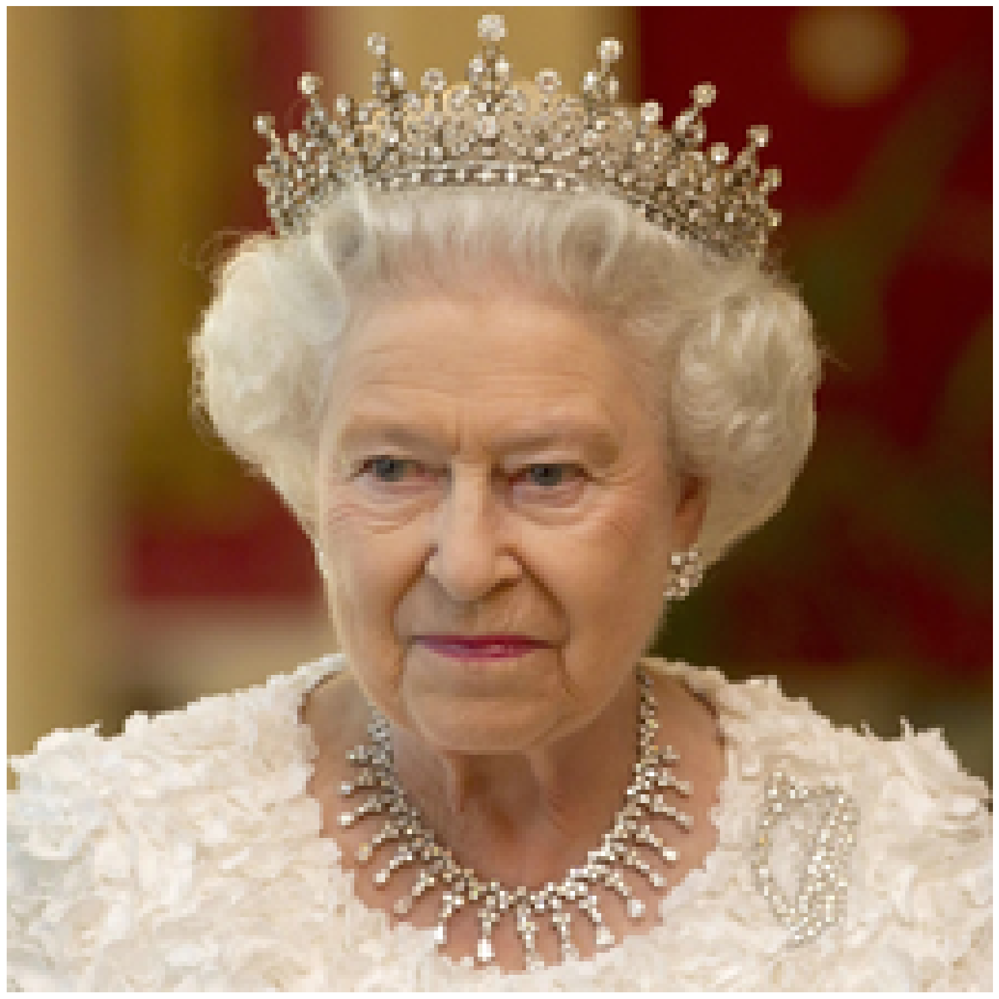

In [24]:
# Implement images embeddings algebra
men_img = '../datasets/embeddings_algebra/men.jpg'
women_img = '../datasets/embeddings_algebra/women.jpg'
king_img = '../datasets/embeddings_algebra/king.jpg'

# king + women - men = ?
result_vector = st._get_query_vector(king_img) + st._get_query_vector(women_img) - st._get_query_vector(men_img)
result = st._search_by_vector(result_vector, 1)

# Plot the result images
st.plot_images(images_df=pd.DataFrame(list(result.values()), columns=['image_path'])) # queen